<a href="https://colab.research.google.com/github/marcellinus-witarsah/VePay-Go-ML/blob/main/license_plate_object_detection_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Step 1: Install Requirements
Installing the yolov5 folder from this [link](https://github.com/ultralytics/yolov5)  

In [2]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12164, done.
remote: Total 12164 (delta 0), reused 0 (delta 0), pack-reused 12164
Receiving objects: 100% (12164/12164), 11.89 MiB | 31.96 MiB/s, done.
Resolving deltas: 100% (8425/8425), done.
/content/yolov5/yolov5
Setup complete. Using torch 1.11.0+cu113 (Tesla T4)


#Step 2: Dataset Preparation
After collecting our data, we will be using roboflow (can be accessed from this [link](https://roboflow.com/)) which is a tool for anotating region of interest. In this case, the region of interest is license plate. After anotating, we can export into any form of a dataset that will be accepted by our model. We can export it manually or using an API. 

In Roboflow, you can choose between two paths:

* Convert an existing dataset to YOLOv5 format. Roboflow supports over [30 formats object detection formats](https://roboflow.com/formats) for conversion.
* Upload raw images and annotate them in Roboflow with [Roboflow Annotate](https://docs.roboflow.com/annotate).


In [3]:
%cd /content/yolov5
# after following the link above, recieve python code with these fields filled in
from roboflow import Roboflow
rf = Roboflow(api_key="QO4DMMa7NTdZ7ZLqskzh")
project = rf.workspace("capstone-project-wpxpu").project("vepay-license-plate-detection-wufwj")
dataset = project.version(1).download("yolov5")

/content/yolov5
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to vepay-license-plate-detection-1 in yolov5pytorch:: 100%|██████████| 6666/6666 [00:07<00:00, 851.78it/s] 


In [4]:
print(dataset.location)
%cat {dataset.location}/data.yaml

/content/yolov5/vepay-license-plate-detection-1
names:
- license-plate
nc: 1
train: vepay-license-plate-detection-1/train/images
val: vepay-license-plate-detection-1/valid/images


In [5]:
import yaml
with open(os.path.join(dataset.location, "data.yaml"), "r") as stream:
    try:
        content = yaml.safe_load(stream) 
        num_classes= content['nc']
        print('num of classes = ', num_classes)
    except yaml.YAMLError as exc:
        print(exc)

# number of classes
print(num_classes)

num of classes =  1
1


# Step 3: Configure YOLOv5 Model
We can do this configuring the .yaml file of that model that has been provided inside the yolov5 repo that we clone. Using **%%writetemplate** (magic command in Python Notebook) to automatically create a new file and configure

In [6]:
# Using this line of code to be able to edit a .yaml file using colab cells
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [7]:
# edit the parameter inside the yolov5s6.yaml
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]


In [ ]:
# # copy the custom_yolov5n6.yaml to project drive
# !mkdir {PROJECT_DRIVE}/models
# !cp /content/yolov5/models/custom_yolov5s6.yaml {PROJECT_DRIVE}/models/custom_yolov5s6.yaml

# Step 4: Training Yolov5 Model
Since we will be preparing a python script (from /yolov5/train.py) for training, there are some arguments that we need to consider which are:
1. ***img:*** define input image size
2. ***batch:*** determine batch size
3. ***epochs:*** define the number of training epochs. (Note: often, 3000+ are common here!).
4. ***data:*** set the path to our yaml file.
5. ***cfg:*** specify our model configuration.
6. ***weights:*** specify a custom path to weights (if the file doesn't exist the model pretrained weights will be downloaded automatically)
7. ***cache:*** cache images for faster training. The default value for this argument is using 'RAM' we can change it to using 'disk' for more storage.
8. ***project:*** folder for results
9. ***name:*** result names inside the **project** folder
10. ***freeze:*** for input how many layers that want to be freezed start from index zero to n-1 layer. For transfer learning we usually freeze the **backbone layers**. (transfer learning)
11. ***hyp:*** hyperparameter for training

Traing from scratch for yolov5s

In [12]:
%%time
%cd /content/yolov5
!python train.py --img 640 \
--batch 32 \
--epochs 50 \
--data {dataset.location}/data.yaml \
--weights ' ' \
--cfg /content/yolov5/models/custom_yolov5s.yaml \
--cache \
--project lpod_train_results \
--name train_vlpd1_5s_scratch

/content/yolov5
train: weights= , cfg=/content/yolov5/models/custom_yolov5s.yaml, data=/content/yolov5/vepay-license-plate-detection-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=lpod_train_results, name=train_vlpd1_5s_scratch, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-242-ga80dd66 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls

if error dataset not found configure the path in the data.yaml inside the dataset

# Step 5: Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

In [13]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir lpod_train_results

<IPython.core.display.Javascript object>

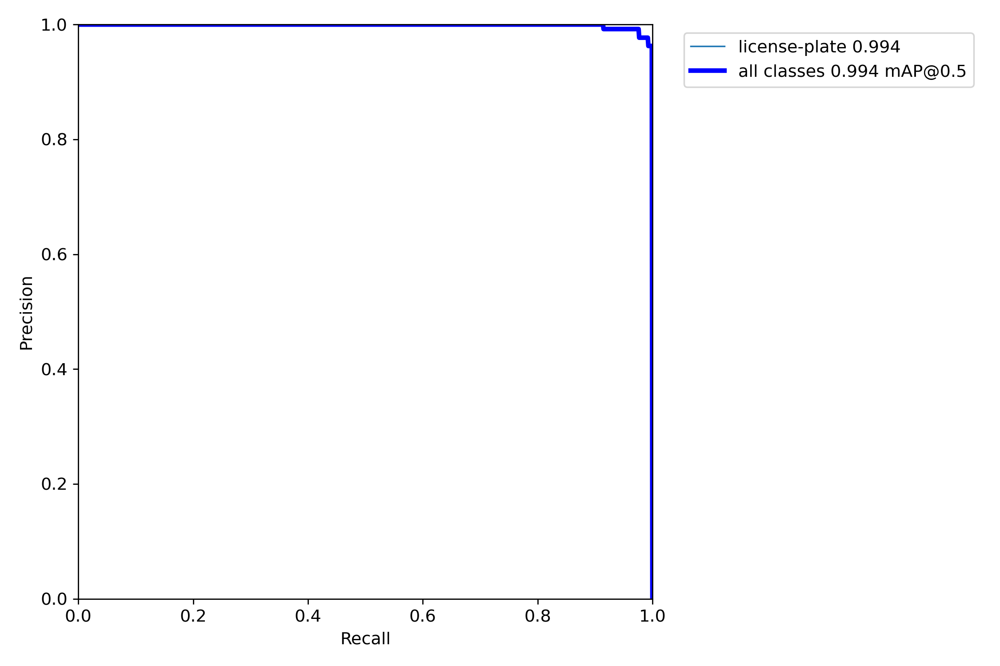

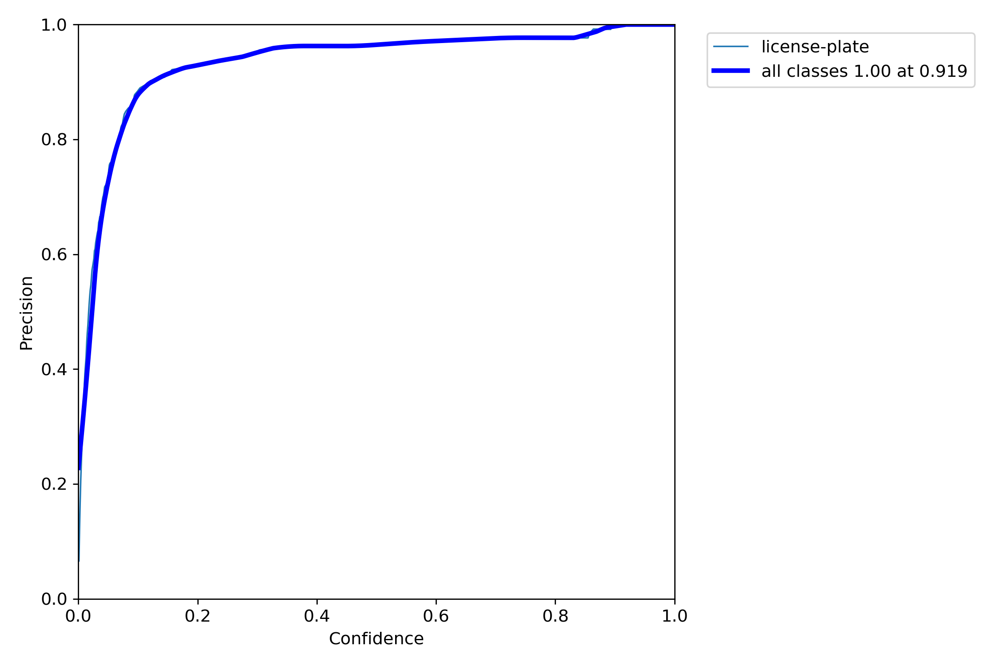

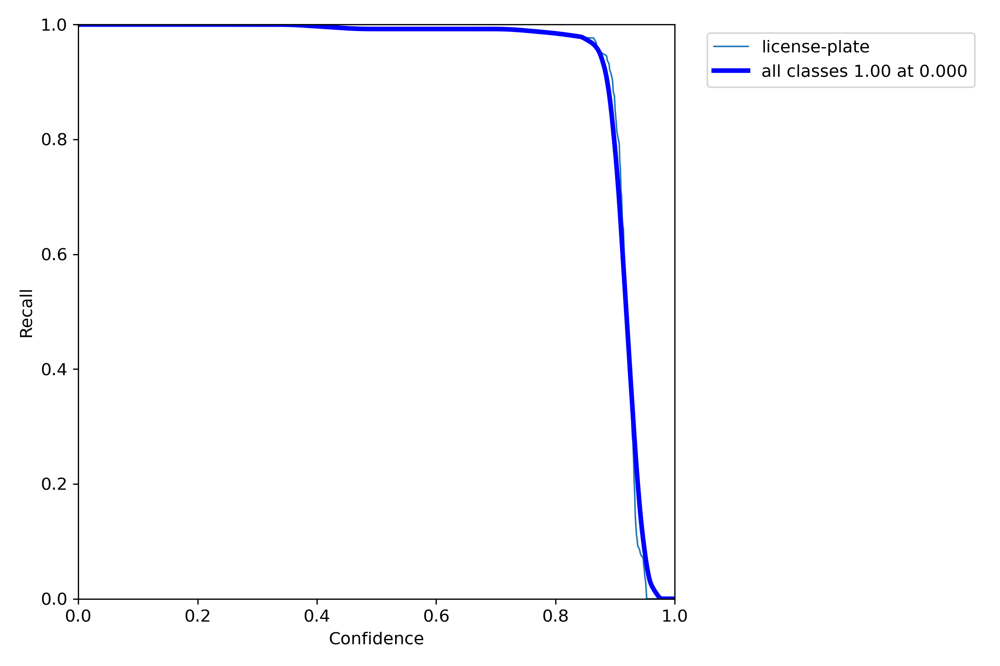

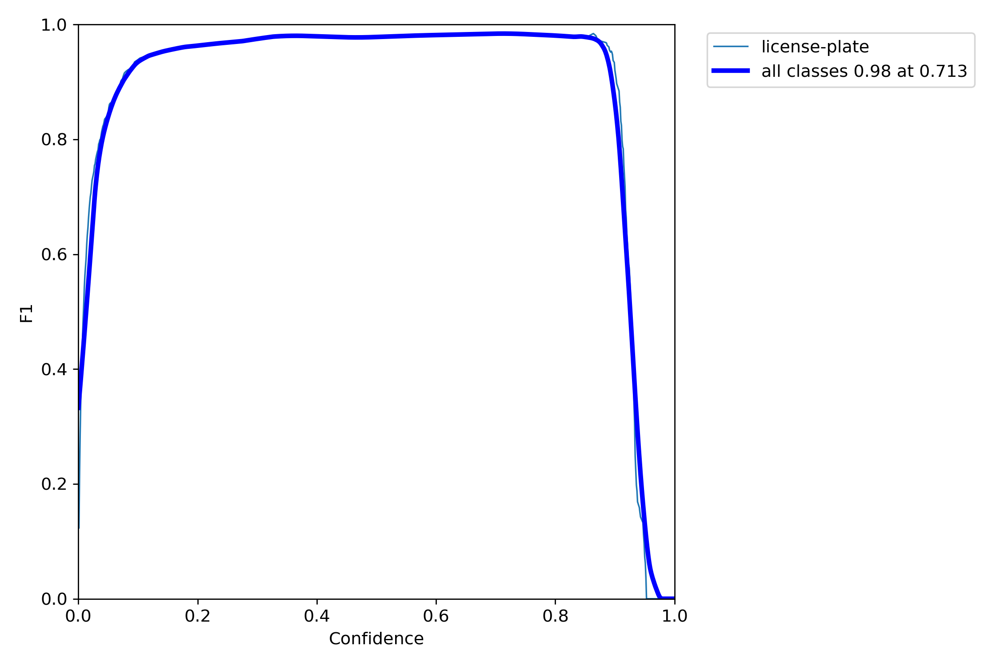

In [20]:
# take a look at the P_curve, R_curve, F1_curve, and PR_curve

#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/lpod_train_results/train_vlpd1_5s_scratch/*_curve.png'): #assuming JPG
    display(Image(filename=imageName, height=500))
    print("\n")

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [15]:
!python detect.py --weights /content/yolov5/lpod_train_results/train_vlpd1_5s_scratch/weights/best.pt --img 640 --conf 0.7 --source {dataset.location}/test/images

detect: weights=['/content/yolov5/lpod_train_results/train_vlpd1_5s_scratch/weights/best.pt'], source=/content/yolov5/vepay-license-plate-detection-1/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.7, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-242-ga80dd66 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
custom_YOLOv5s summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/126 /content/yolov5/vepay-license-plate-detection-1/test/images/09f3b4af-7fc1-46f8-9236-e9953e5e1260_jpg.rf.0813f2e19eb96dc972842c2009da06c9.jpg: 480x640 1 license-plate, Done. (0.019s)
image 2/126 /content/yolov5/vepay-license-plate-detection-1/test/images/0af

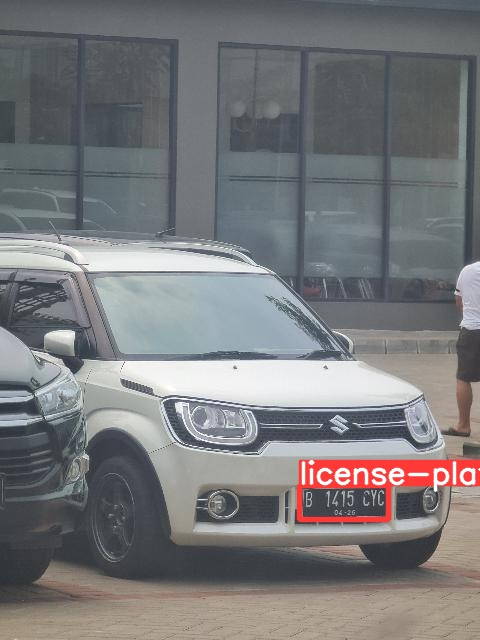

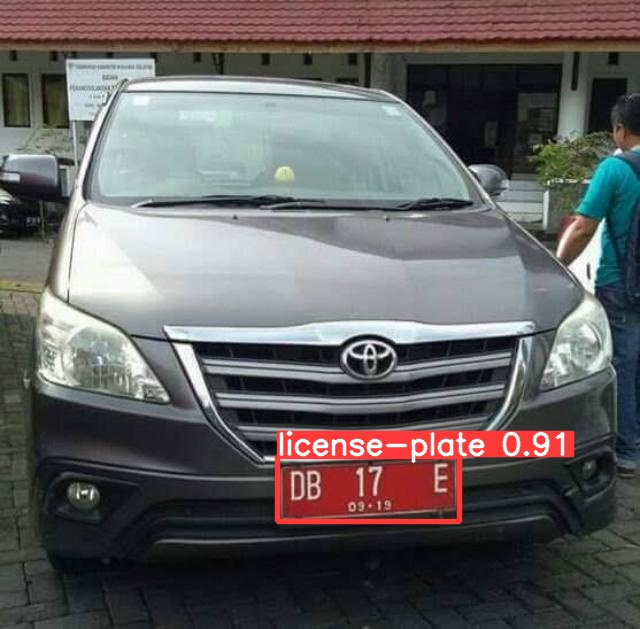

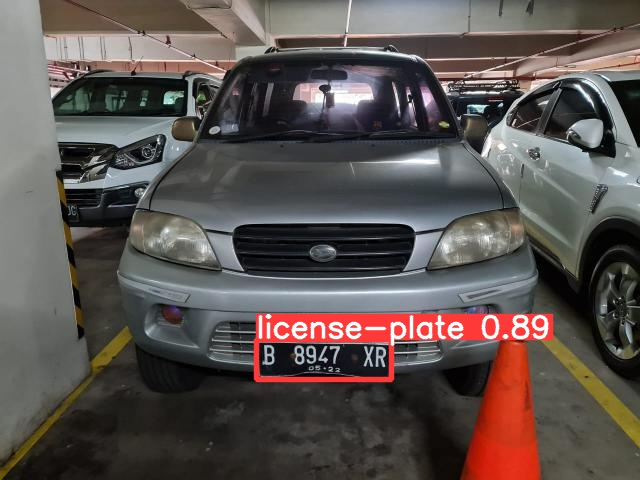

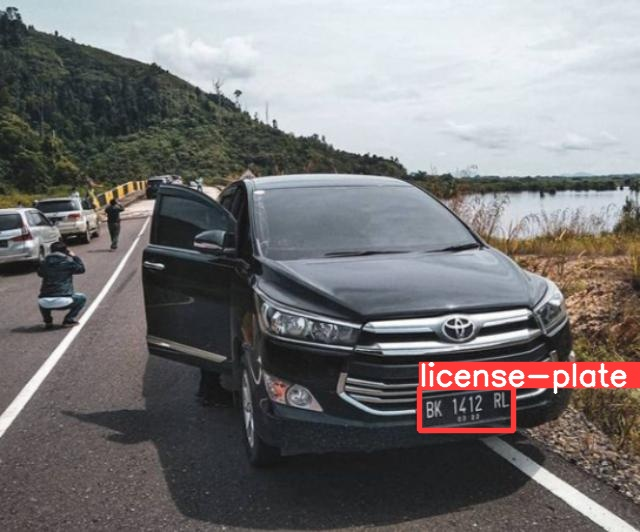

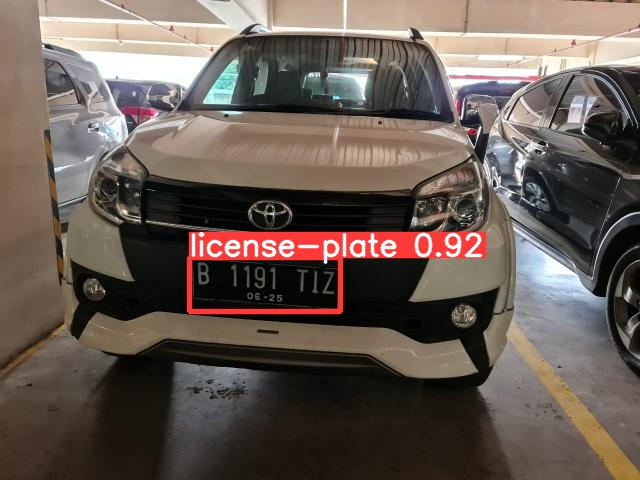

...

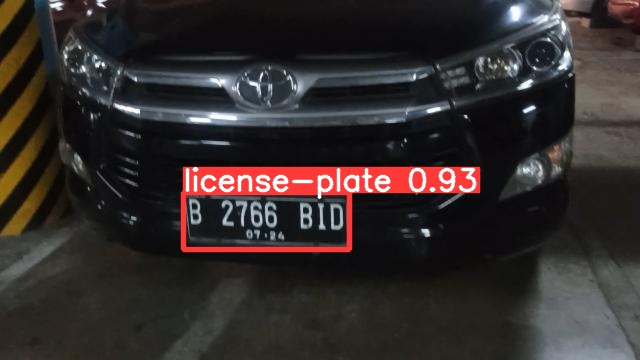

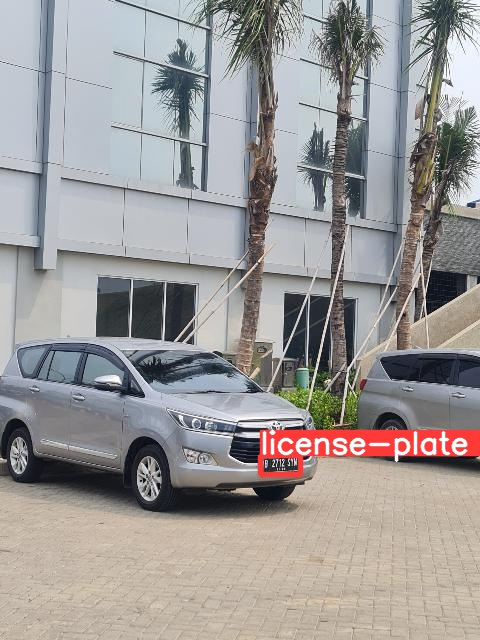

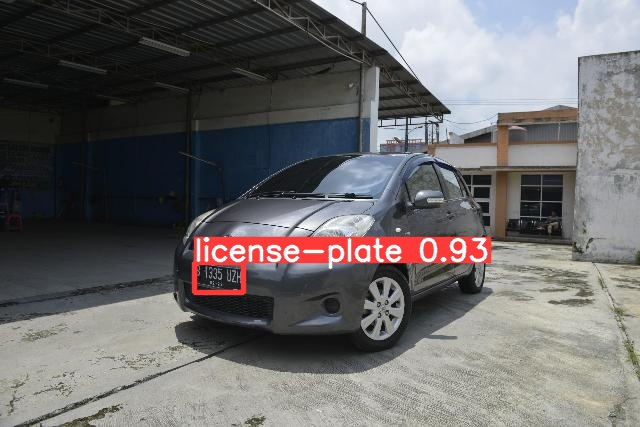

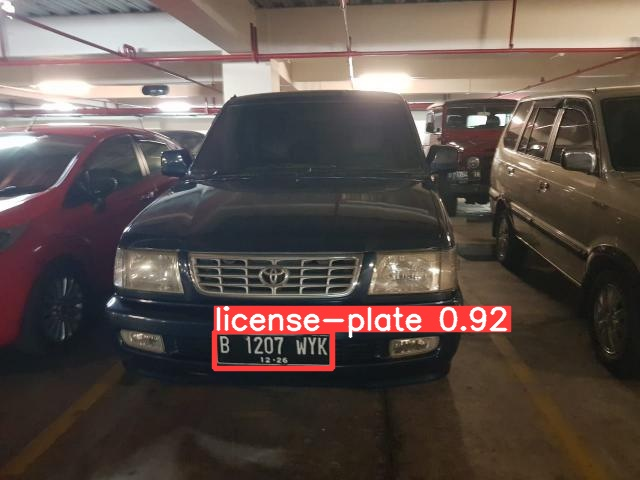

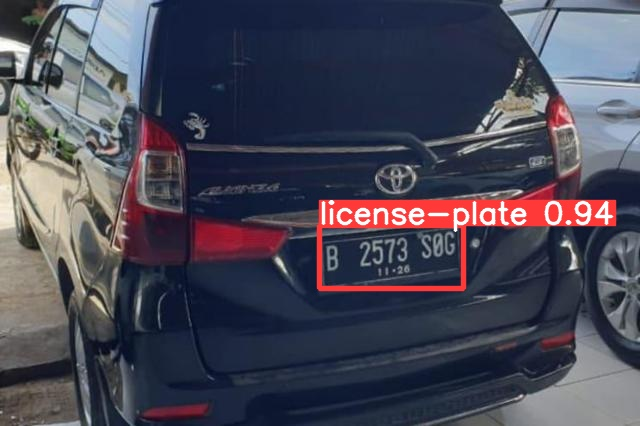

In [16]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Save Trained Results and Weights to Google Drive

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [21]:
# Connect to Google drive
from google.colab import drive
drive.mount('/content/drive')

# constants for project path
# project path can be any location
PROJECT_DRIVE = '/content/drive/MyDrive/capstone-bangkit-2022/license-plate-object-detection'
FOLDER_TRAIN_RESULTS = os.path.join(PROJECT_DRIVE, 'train_results')


Mounted at /content/drive


In [29]:
# store to the PROJECT_DRIVE
!cp -r /content/yolov5/lpod_train_results/train_vlpd1_5s_scratch {PROJECT_DRIVE}